In [3]:
using AbstractFFTs
using FFTW
using Plots

function meshgrid(x_,y_)
    lenx = length(y_)
    leny = length(x_)
    x = x_'.* ones(lenx)
    y = ones(leny)'.* y_
    return x,y
end

mutable struct Fluid
    nx::Int
    ny::Int
    nk::Int
    Re::Int
    ReI::Float64
    dt::Float64
    pad::Float64
    time::Float64
    it::Int
    fftw_num_threads
    x 
    dx
    y 
    dy
    kx
    ky
    fk
    k2
    k2I
    mx
    mk
    my
    padder 
    u
    v
    w
    f
    uh 
    vh 
    wh0
    wh 
    fh 
    psih 
    dwhdt

end

function construct(grid_size)
    # input data
    nx = grid_size
    ny = grid_size
    nk = ny÷2+1
    Re = 100
    ReI = 0
    if Re != 0
        ReI = 1/Re
    end
    dt = 0.0001
    pad = 3/2
    time = 0
    it = 0

    fftw_num_threads = 8

    # we assume 2pi periodic domain in each dimensions
    x = range(0, 2*pi, nx+1)[1:end-1]
    dx = x[2]-x[1]
    y = range(0, 2*pi, ny+1)[1:end-1]
    dy = y[2]-y[1]

    kx = fftfreq(nx) .* nx
    ky = fftfreq(ny) .* ny

    kxs, kys = meshgrid(kx[1:nk], ky)

    k2 = kxs.^2 .+ kys.^2
    k2I = zeros(nx, nk)
    fk = k2 .!= 0.0
    k2I[fk] = 1.0 ./ k2[fk]

    mx = convert(Int, floor(pad*nx))
    mk = convert(Int, floor(pad*nk))
    my = convert(Int, floor(pad*ny))

    padder = convert(Array{Bool}, ones(Int, mx))
    padder[convert(Int, nx/2+1):convert(Int, nx*(pad-0.5))] .= false

    u = zeros(nx, ny)
    v = zeros(nx, ny)
    w = zeros(nx, ny)
    f = zeros(nx, ny)

    uh  = zeros(Complex{Float64}, nx, nk)
    vh  = zeros(Complex{Float64}, nx, nk)
    wh0 = zeros(Complex{Float64}, nx, nk)
    wh  = zeros(Complex{Float64}, nx, nk)
    fh  = zeros(Complex{Float64}, nx, nk)
    psih = zeros(Complex{Float64}, nx, nk)
    dwhdt = zeros(Complex{Float64}, nx, nk)

    flow = Fluid(nx, ny, nk, Re, ReI,dt,pad, 
                time, it, fftw_num_threads, 
                x, dx, y, dy, kx, ky, fk, k2, k2I,
                mx, mk, my, padder, u, v, w, 
                f, uh, vh, wh0, wh, fh, psih, dwhdt)
    return flow
end



construct (generic function with 1 method)

In [175]:

function get_u(self::Fluid)
    self.uh = 1im.*self.ky.*self.psih
    self.u = irfft(self.uh, self.nx)
end

function get_v(self::Fluid)
    self.vh = -1im.*self.kx[1:self.nk].*self.psih
    self.v = irfft(self.vh, self.ny)
end

function cfl_limit(self::Fluid)
    get_u(self)
    get_v(self)
    Dc = maximum(π .* ((1.0 .+ abs.(self.u)) ./ self.dx +
                    (1.0 .+ abs.(self.v)) ./ self.dy))
    Dmu = π^2*(self.dx^(-2) + self.dy^(-2))
    return sqrt(3.0) / (Dc + Dmu)
end

function get_psih(self::Fluid)
    self.psih = self.wh .* self.k2I'
end

function add_convection(self::Fluid)
    # padded arrays
    j1f_padded = zeros(Complex{Float64}, self.mx, self.mk)
    j2f_padded = zeros(Complex{Float64}, self.mx, self.mk)
    j3f_padded = zeros(Complex{Float64}, self.mx, self.mk)
    j4f_padded = zeros(Complex{Float64}, self.mx, self.mk)
    #print(size(1.0im .* kx[1:nk].*psih'))
    j1f_padded[self.padder, 1:self.nk] = 1.0im .* self.kx[1:self.nk,:] .* self.psih
    j2f_padded[self.padder, 1:self.nk] = 1.0im .* self.kx .* self.wh
    j3f_padded[self.padder, 1:self.nk] = 1.0im .* self.ky .* self.psih
    j4f_padded[self.padder, 1:self.nk] = 1.0im .* self.kx[1:self.nk,:] .* self.wh

    # ifft
    j1 = irfft(j1f_padded)
    j2 = irfft(j2f_padded)
    j3 = irfft(j3f_padded)
    j4 = irfft(j4f_padded)

    jacp = j1 .* j2 - j3 .* j4


    jacpf = rfft(jacp)

    dwhdt = jacpf[self.padder, 1:self.nk] .* self.pad^(2)  # this term is the result of padding
    return dwhdt
end

function add_diffusion(self::Fluid, dwhdt)
    new_dwhdt = dwhdt .- self.ReI .* self.k2 .* self.wh
    return new_dwhdt
end


function update(self::Fluid)
    # iniitalise field
    self.wh0 = self.wh

    for k=3:-1:1
        # invert Poisson equation for the stream function (changes to k-space)
        get_psih(self)
        
        # get convective forces (resets dwhdt)
        dwhdt = add_convection(self)
        
        # add diffusion
        dwhdt = add_diffusion(self, dwhdt)
        
        # step in time
        self.wh = self.wh0 + (self.dt/k) .* dwhdt
    end
    self.time += self.dt
    self.dt = cfl_limit(self)
    self.it += 1
end

update (generic function with 1 method)

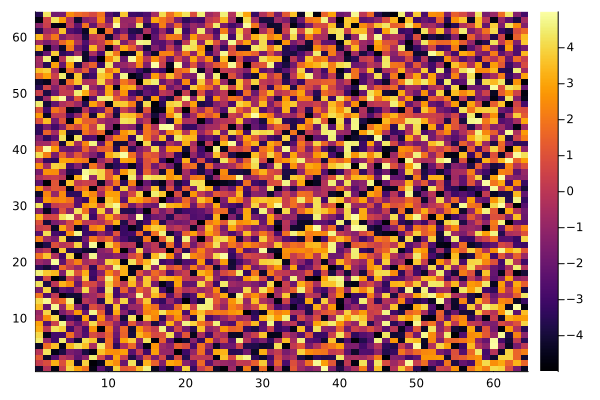

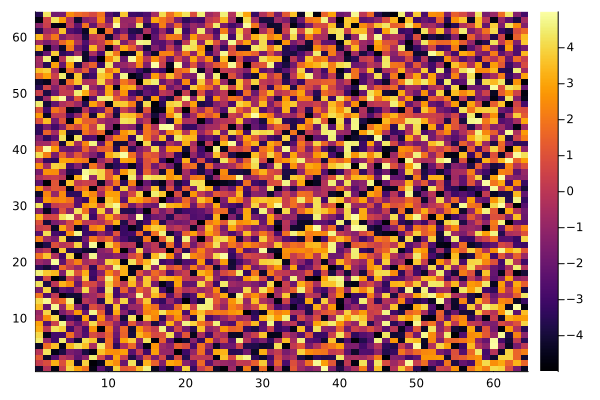

-10.0:0.31746031746031744:10.0

In [176]:
max_iter = 10000
flow = construct(64)

lin = range(-10,10,64)
print(lin)

x,y = meshgrid(lin, lin)
#print(x)
gaussian(A, alpha, x1, x2, y1, y2) = A*(exp.(-alpha.*((x .- x1).^2 + (y .- y1).^2)) 
                                        + exp.(-alpha.*((x .- x2).^2 + (y .- y2).^2)))

#w = gaussian(1, 0.1, 5, -5, -5, 5)#
w = 10.0 .*(rand(flow.nx, flow.ny).-0.5)
#print(w)
display(heatmap(w))

flow.wh = rfft(w)#rand(Complex{Float64},flow.nx, flow.nk)#*10im
display(heatmap(real(irfft(flow.wh, flow.ny))))


In [177]:
flow.k2I

64×33 Matrix{Float64}:
 0.0        1.0        0.25       0.111111   …  0.00104058   0.000976562
 1.0        0.5        0.2        0.1           0.0010395    0.00097561
 0.25       0.2        0.125      0.0769231     0.00103627   0.000972763
 0.111111   0.1        0.0769231  0.0555556     0.00103093   0.000968054
 0.0625     0.0588235  0.05       0.04          0.00102354   0.000961538
 0.04       0.0384615  0.0344828  0.0294118  …  0.0010142    0.000953289
 0.0277778  0.027027   0.025      0.0222222     0.00100301   0.000943396
 0.0204082  0.02       0.0188679  0.0172414     0.000990099  0.000931966
 0.015625   0.0153846  0.0147059  0.0136986     0.00097561   0.000919118
 0.0123457  0.0121951  0.0117647  0.0111111     0.000959693  0.000904977
 ⋮                                           ⋱               
 0.0123457  0.0121951  0.0117647  0.0111111  …  0.000959693  0.000904977
 0.015625   0.0153846  0.0147059  0.0136986     0.00097561   0.000919118
 0.0204082  0.02       0.0188679  0.0172

In [178]:

for i=1:max_iter
    if i%1000==0 
        display(heatmap(real(fft(flow.wh))))
        #println(flow.wh)
    end
    update(flow)
end
display(heatmap(real(fft(flow.wh))))


DimensionMismatch: DimensionMismatch: tried to assign 33×64 array to 64×33 destination

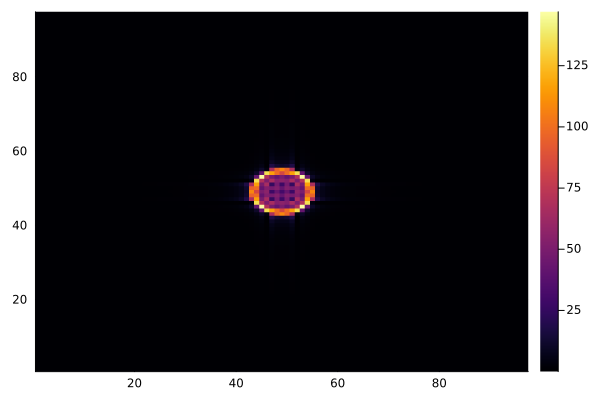

In [4]:
m = rand(10,10)
f = [(r = sqrt(x^2 + y^2); sinc(r)) for x in -6:0.125:6, y in -6:0.125:6]
mh = fft(f)
heatmap(abs.(fftshift(mh)))

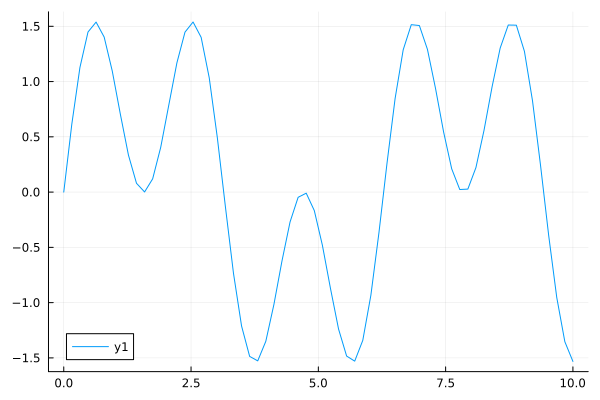

In [142]:
lin = range(0,10,64)
test = sin.(lin) + sin.(3*lin)
plot(lin, test)

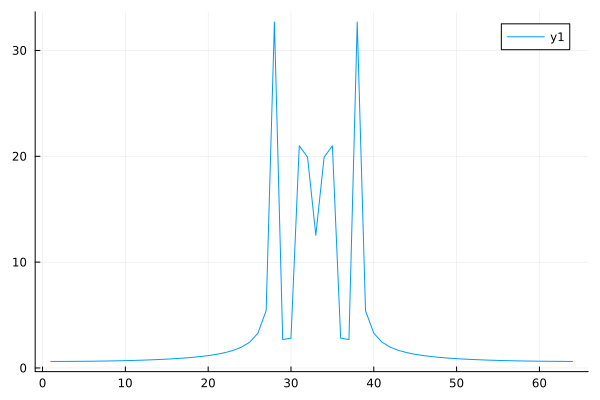

In [143]:
testh = fft(test)
plot(abs.(fftshift(testh)))

In [144]:
x,y = meshgrid(lin, 2 .*lin)
test = sin.(x) + sin.(3*y)

64×64 Matrix{Float64}:
  0.0        0.158064   0.312155    …  -0.254917   -0.404555   -0.544021
  0.814798   0.972863   1.12695         0.559881    0.410243    0.270777
  0.94475    1.10281    1.2569          0.689833    0.540195    0.400729
  0.280629   0.438694   0.592784        0.0257125  -0.123925   -0.263392
 -0.619363  -0.461299  -0.307208       -0.87428    -1.02392    -1.16338
 -0.998774  -0.84071   -0.68662     …  -1.25369    -1.40333    -1.5428
 -0.538705  -0.380641  -0.22655        -0.793622   -0.94326    -1.08273
  0.374151   0.532216   0.686306        0.119234   -0.0304035  -0.16987
  0.97253    1.13059    1.28468         0.717613    0.567975    0.428509
  0.753487   0.911551   1.06564         0.49857     0.348932    0.209466
  ⋮                                 ⋱                          
  0.855296   1.01336    1.16745     …   0.60038     0.450742    0.311275
  0.073675   0.231739   0.38583        -0.181242   -0.33088    -0.470346
 -0.769871  -0.611807  -0.457716       -1.

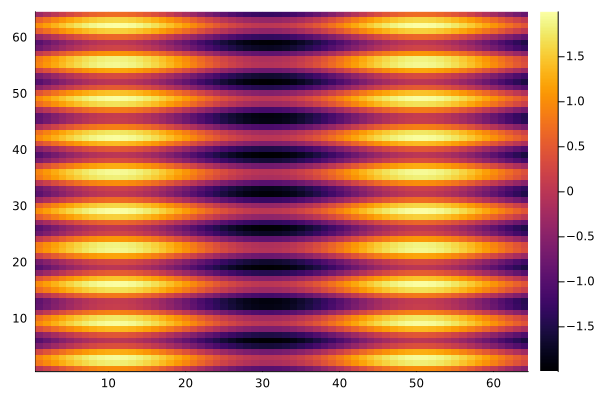

In [145]:
heatmap(test)

(33, 64)

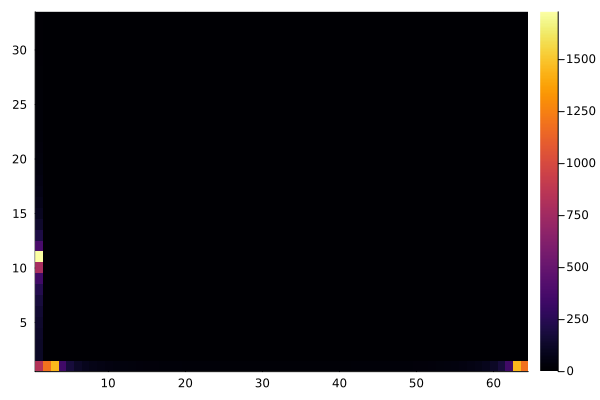

In [179]:
mh = rfft(test)
print(size(mh))
heatmap(abs.(mh))

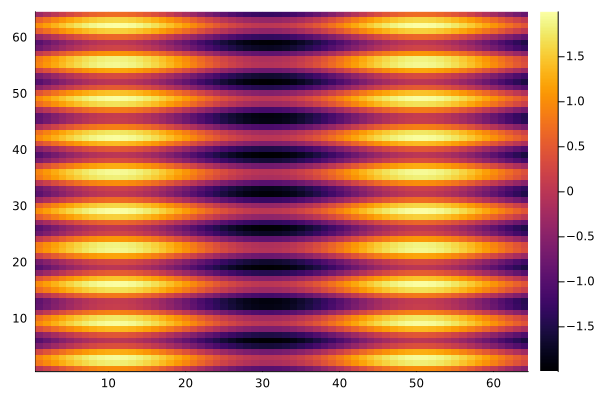

In [149]:
xn = irfft(mh,64)
heatmap(real(xn))

In [2]:
using FFTW

function heat_eq_pseudo_spectral_2d(u::AbstractArray, t::Float64)
    # Compute the spatial derivatives using the pseudo-spectral method
    û = fft(u)
    û = û .* (-(2π / size(u, 1))^2 * (0:size(u, 1) - 1).^2 .- (2π / size(u, 2))^2 * (0:size(u, 2) - 1).^2)
    û[1, 1] = 0.0
    ũ = ifft(û)
    
    # Advance the solution in time using the Euler method
    dt = 0.1
    u .= u + dt * ũ
end

# Initialize the solution
N = 128
u = sin.(2π * (0:N-1) / N) * cos.(2π * (0:N-1) / N)'

# Evolve the solution in time
for t in 1:100
    heat_eq_pseudo_spectral_2d(u, t * 0.1)
end

InexactError: InexactError: Float64(9.340844787866459e-17 - 3.886156732928935im)

In [2]:
using Plots


┌ Info: Saved animation to /tmp/jl_8fy16TMN2v.gif
└ @ Plots /home/max/.julia/packages/Plots/M4dfL/src/animation.jl:156


Plots.AnimatedGif("/tmp/jl_8fy16TMN2v.gif")
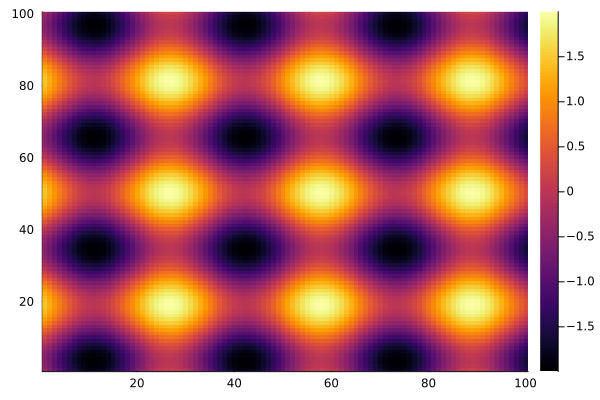

In [8]:
@userplot CirclePlot
@recipe function f(cp::CirclePlot)
    x, y, i = cp.args
    n = length(x)
    inds = circshift(1:n, 1 - i)
    linewidth --> range(0, 10, length = n)
    seriesalpha --> range(0, 1, length = n)
    aspect_ratio --> 1
    label --> false
    x[inds], y[inds]
end

n = 150
lin = range(-10,10,100)
x,y = meshgrid(lin, lin)
z(t) = sin.(0.1.*t.+x) + cos.(0.1.*t.+y)


@gif for i ∈ 1:n
    heatmap(z(i))
    #circleplot(x, y, i, line_z = 1:n, cbar = false, framestyle = :zerolines)
end 

┌ Info: Saved animation to /home/max/Dropbox/Plasmaastro/anim_fps15.gif
└ @ Plots /home/max/.julia/packages/Plots/M4dfL/src/animation.jl:156


Plots.AnimatedGif("/home/max/Dropbox/Plasmaastro/anim_fps15.gif")
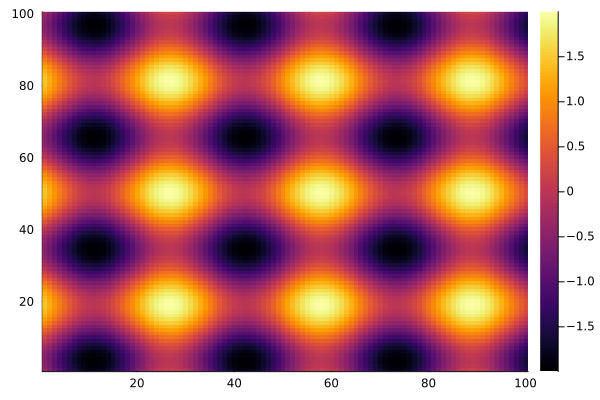

In [10]:
anim = @animate for i ∈ 1:n
    heatmap(z(i))
end
gif(anim, "anim_fps15.gif", fps = 15)